<a href="https://colab.research.google.com/github/mwkoehler/xlnet/blob/main/XLNet_topic_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install transformers
!pip install sentencepiece
!pip install ordered-set

     |████████████████████████████████| 1.9MB 21.2MB/s 
     |████████████████████████████████| 890kB 48.3MB/s 
     |████████████████████████████████| 3.2MB 53.1MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp37-none-any.whl size=893262 sha256=34ac288c1e750a185b68af4d8d9a52c408e43e32f3464d32dc787993065524ea
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built sacremoses
     |████████████████████████████████| 1.2MB 17.6MB/s 
  Created wheel for ordered-set: filename=ordered_set-4.0.2-py2.py3-none-any.whl size=8210 sha256=1634432839fa12b5300d62356fc4ab34c1604e5bc29fd0ccf421a4f1761e0804
  Stored in directory: /root/.cache/pip/wheels/e1/c6/9b/651d8a21d59b51a75ab9c070838f9231b8126421bc0569af47
Successfully built ordered-set


In [2]:
import os
import math

import torch
from torch.nn import BCEWithLogitsLoss
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from transformers import AdamW, XLNetTokenizer, XLNetModel, XLNetLMHeadModel, XLNetConfig
from keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
from tqdm import tqdm, trange
from ordered_set import OrderedSet
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
print("GPU Available: {}".format(torch.cuda.is_available()))
n_gpu = torch.cuda.device_count()
print("Number of GPU Available: {}".format(n_gpu))
print("GPU: {}".format(torch.cuda.get_device_name(0)))

GPU Available: True
Number of GPU Available: 1
GPU: Tesla T4


In [4]:
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Import Dataset

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
all = pd.read_json('/content/drive/My Drive/data/alldocs.json', orient='records')
all.columns = ['id', 'tags', 'text', 'lemmas']
all

,id,tags,text,lemmas
0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ..."
1,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu..."
2,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai..."
3,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut..."
4,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b..."
...,...,...,...,...
4233,993690193,[programming],Learning to live with errors\nhttp://tomasp.ne...,"[learn, live, error, tomasp, net, blog, failur..."
4234,993949057,[powershell],Git for IT Professionals: Life Cycle of Reposi...,"[git, profession, life, cycl, repositori, file..."
4235,994814531,[computersecurity],How To Put Data At The Heart Of Your Security ...,"[put, data, heart, secur, practic, darkread, c..."
4236,997556985,[travel],The Best Last-Minute Weekend Getaways From New...,"[best, last, minut, weekend, getaway, new, yor..."


In [7]:
def to_1D(series):
 return pd.Series([x for _list in series for x in _list])

In [8]:
tagSet = set(to_1D(all['tags']))
tagList = sorted(tagSet)
tagList

['3dprint',
 'aclu',
 'amazon',
 'android',
 'antitrust',
 'apple',
 'apps',
 'asana',
 'auth0',
 'azure',
 'backyard',
 'biden',
 'biology',
 'bitcoin',
 'books',
 'brain',
 'charity',
 'china',
 'chrissy',
 'ci/cd',
 'class',
 'climate',
 'color',
 'compsci',
 'computer',
 'computererrors',
 'computersecurity',
 'conservatism',
 'conspiracies',
 'conversations',
 'cooperstown',
 'cosmosdb',
 'covid',
 'cpp',
 'creativity',
 'csharp',
 'css',
 'data science',
 'datacenter',
 'datasets',
 'debug',
 'deep learning',
 'design',
 'devops',
 'devtools',
 'documentdb',
 'drives',
 'drone',
 'economics',
 'eff',
 'ethics',
 'evernote',
 'ewaste',
 'exercide',
 'exercise',
 'facebook',
 'fashion',
 'fiction',
 'fix',
 'food',
 'foodanddrink',
 'fraud',
 'fsharp',
 'functional programming',
 'furniture',
 'future',
 'game theory',
 'games',
 'geocoding',
 'git',
 'gov',
 'gpt3',
 'graphapi',
 'gtd',
 'gwern',
 'happy',
 'health',
 'history',
 'home',
 'homeautomation',
 'html',
 'humans',
 'ic

In [9]:
# '[]' in all['tags'].to_string()
testList = []
for index, row in all.iterrows():
    if len(row['tags']) == 0:
      testList.append(row.to_list())
test = pd.DataFrame(testList, columns=['id', 'tags', 'text', 'lemmas'])
test.head()

,id,tags,text,lemmas
0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ..."
1,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b..."
2,1016000946,[],Raft Consensus Algorithm\nhttps://raft.github....,"[raft, consensus, algorithm, raft, raft, imple..."
3,1017755607,[],0xd4d/dnSpy\nhttps://github.com/0xd4d/dnSpy\nC...,"[dnspi, com, dnspi, call, stack, thread, modul..."
4,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,..."


In [10]:
trainList = []
for index, row in all.iterrows():
    if len(row['tags']) != 0:
      trainList.append(row.to_list())
train = pd.DataFrame(trainList, columns=['id', 'tags', 'text', 'lemmas'])
train.head()

,id,tags,text,lemmas
0,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu..."
1,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai..."
2,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut..."
3,1014049969,[money],This Calculator Will Help You Decide Between a...,"[calcul, help, decid, roth, tradit, ira, twoce..."
4,1014488418,[powershell],Powershell: Search all Event Logs Within a Spe...,"[powershel, search, event, log, within, specif..."


In [11]:
train.shape

(2831, 4)

In [12]:
test.shape

(1407, 4)

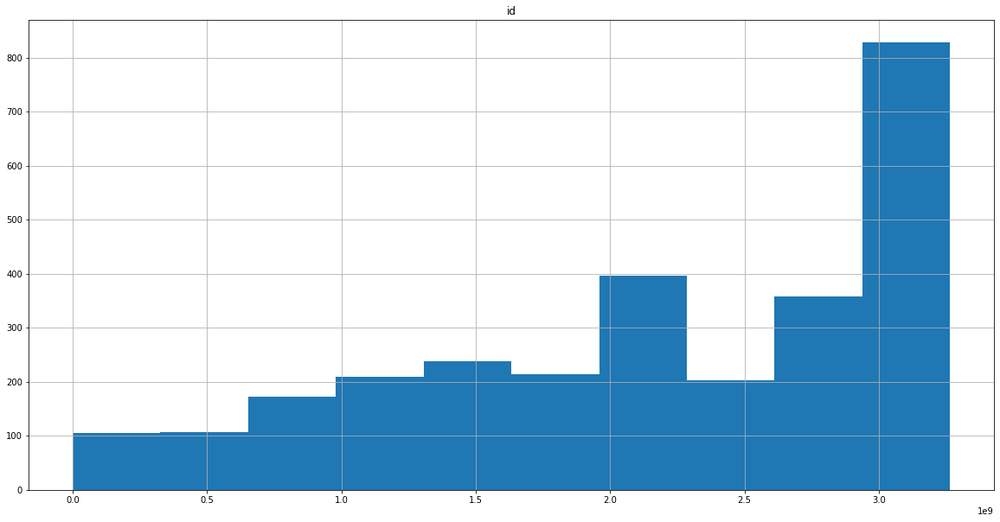

In [13]:
fig, ax = plt.subplots(figsize=(20, 10));
train[["id", "text"]].hist(ax=ax);

In [14]:
train.isnull().mean()

id        0.0
tags      0.0
text      0.0
lemmas    0.0
dtype: float64

In [15]:
test.isnull().mean()

id        0.0
tags      0.0
text      0.0
lemmas    0.0
dtype: float64

In [16]:
# get small sample of train to try
#train = train.sample(n=100)

## Preprocess Data

In [17]:
def plot_sentence_embeddings_length(text_list, tokenizer):
    tokenized_texts = list(map(lambda t: tokenizer.tokenize(t), text_list))
    tokenized_texts_len = list(map(lambda t: len(t), tokenized_texts))
    fig, ax = plt.subplots(figsize=(8, 5));
    ax.hist(tokenized_texts_len, bins=40);
    ax.set_xlabel("Length of Comment Embeddings");
    ax.set_ylabel("Number of Comments");
    return

In [18]:
tokenizer = XLNetTokenizer.from_pretrained('xlnet-base-cased', do_lower_case=True)

In [19]:
train_text_list = train["text"].values
test_text_list = test["text"].values

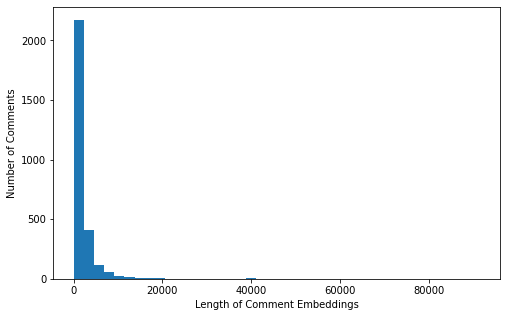

In [20]:
plot_sentence_embeddings_length(train_text_list, tokenizer)

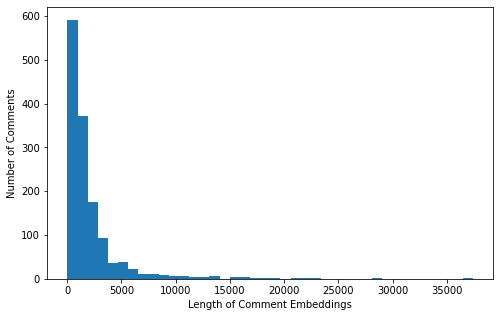

In [21]:
plot_sentence_embeddings_length(test_text_list, tokenizer)

In [22]:
def tokenize_inputs(text_list, tokenizer, num_embeddings=512):
    """
    Tokenizes the input text input into ids. Appends the appropriate special
    characters to the end of the text to denote end of sentence. Truncate or pad
    the appropriate sequence length.
    """
    # tokenize the text, then truncate sequence to the desired length minus 2 for
    # the 2 special characters
    tokenized_texts = list(map(lambda t: tokenizer.tokenize(t)[:num_embeddings-2], text_list))
    # convert tokenized text into numeric ids for the appropriate LM
    input_ids = [tokenizer.convert_tokens_to_ids(x) for x in tokenized_texts]
    # append special token "<s>" and </s> to end of sentence
    input_ids = [tokenizer.build_inputs_with_special_tokens(x) for x in input_ids]
    # pad sequences
    input_ids = pad_sequences(input_ids, maxlen=num_embeddings, dtype="long", truncating="post", padding="post")
    return input_ids

def create_attn_masks(input_ids):
    """
    Create attention masks to tell model whether attention should be applied to
    the input id tokens. Do not want to perform attention on padding tokens.
    """
    # Create attention masks
    attention_masks = []

    # Create a mask of 1s for each token followed by 0s for padding
    for seq in input_ids:
        seq_mask = [float(i>0) for i in seq]
        attention_masks.append(seq_mask)
    return attention_masks

In [23]:
# create input id tokens
train_input_ids = tokenize_inputs(train_text_list, tokenizer, num_embeddings=250)
train_input_ids

array([[  611,   190,    80, ...,     0,     0,     0],
       [ 8075,  7791,    71, ...,   286,     4,     3],
       [   24, 16513,   108, ..., 17115,     4,     3],
       ...,
       [  160,    22,   331, ...,   434,     4,     3],
       [   18,   252,   129, ...,    19,     4,     3],
       [   17,  4501,  6038, ...,  4501,     4,     3]])

In [24]:
# create input id tokens
test_input_ids = tokenize_inputs(test_text_list, tokenizer, num_embeddings=250)
test_input_ids

array([[13295,  9756,    25, ...,    86,     4,     3],
       [  534,   649,    20, ...,  1992,     4,     3],
       [15297,  7169, 13301, ...,    27,     4,     3],
       ...,
       [ 2172,   594,  3046, ...,  1038,     4,     3],
       [  182,  2141,    20, ...,    18,     4,     3],
       [  808,    73, 21810, ...,  1319,     4,     3]])

In [25]:
# create attention masks
train_attention_masks = create_attn_masks(train_input_ids)
train_attention_masks

[[1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,
  0.0,

In [26]:
# create attention masks
test_attention_masks = create_attn_masks(test_input_ids)
test_attention_masks

[[1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,

In [27]:
# add input ids and attention masks to the dataframe
train["features"] = train_input_ids.tolist()
train["masks"] = train_attention_masks

test["features"] = test_input_ids.tolist()
test["masks"] = test_attention_masks

In [28]:
train.head()

,id,tags,text,lemmas,features,masks
0,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu...","[611, 190, 80, 1266, 3512, 15320, 156, 9, 279,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
1,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai...","[8075, 7791, 71, 254, 10229, 826, 7950, 37, 21...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
2,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut...","[24, 16513, 108, 167, 10067, 22146, 9295, 25, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
3,1014049969,[money],This Calculator Will Help You Decide Between a...,"[calcul, help, decid, roth, tradit, ira, twoce...","[52, 11873, 53, 222, 44, 2263, 161, 24, 17, 98...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
4,1014488418,[powershell],Powershell: Search all Event Logs Within a Spe...,"[powershel, search, event, log, within, specif...","[350, 17637, 60, 987, 71, 746, 17385, 364, 24,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."


In [29]:
test.head()

,id,tags,text,lemmas,features,masks
0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ...","[13295, 9756, 25, 18957, 6687, 213, 218, 4538,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
1,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b...","[534, 649, 20, 31356, 13470, 4538, 23, 4315, 3...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
2,1016000946,[],Raft Consensus Algorithm\nhttps://raft.github....,"[raft, consensus, algorithm, raft, raft, imple...","[15297, 7169, 13301, 4538, 23, 4315, 840, 2378...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
3,1017755607,[],0xd4d/dnSpy\nhttps://github.com/0xd4d/dnSpy\nC...,"[dnspi, com, dnspi, call, stack, thread, modul...","[700, 469, 66, 265, 66, 167, 66, 3673, 4546, 4...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
4,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,...","[49, 2731, 19945, 792, 832, 8097, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."


## Train, Valid Split

In [30]:
# train valid split
train, valid = train_test_split(train, test_size=0.2, random_state=42)

In [31]:
col = []
for tag in tagList:
  for index, row in train.iterrows():
      if tag in row['tags']:
        col.append(1)
      else:    
        col.append(0)
  train[tag] = col
  col = []
  for index, row in valid.iterrows():
      if tag in row['tags']:
        col.append(1)
      else:    
        col.append(0)
  valid[tag] = col
  col = []
  

In [32]:
train.head()

,id,tags,text,lemmas,features,masks,3dprint,aclu,amazon,android,antitrust,apple,apps,asana,auth0,azure,backyard,biden,biology,bitcoin,books,brain,charity,china,chrissy,ci/cd,class,climate,color,compsci,computer,computererrors,computersecurity,conservatism,conspiracies,conversations,cooperstown,cosmosdb,covid,cpp,...,sip,snowden,solar,space,spacy,sparkfile,spectre,sql,statistics,stb,swagger,sysadmin,sysctr,tax,tdd,technology,testing,toomanylaws,travel,travelhacking,trump,typescript,unions,visualstudio,voting,vpn,vscode,vsto,waitbutwhy,walking,watch,wedding,wifi,will,windows,xamarin,xaml,xml,xpath,zettelkasten
2740,815864113,[money],Taxes: What's New for 2015?\nhttp://www.schwab...,"[tax, new, schwab, com, public, schwab, articl...","[2905, 60, 113, 26, 23, 109, 28, 2607, 82, 453...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2345,3155215265,[food],Chicken Cordon Bleu with a Creamy Marsala Wine...,"[chicken, cordon, bleu, creami, marsala, wine,...","[5746, 7776, 253, 17, 3584, 660, 33, 24, 26104...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1567,2861802386,[humans],What Neapolitans Understand About Death (Bette...,"[neapolitan, understand, death, good, lithub, ...","[113, 17, 21026, 5144, 3524, 23, 1111, 75, 513...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2565,491693781,[programming],Project Oberon (New Edition 2013)\nhttps://inf...,"[project, oberon, new, edit, inf, ethz, person...","[686, 6837, 118, 253, 17, 10, 4652, 3414, 2521...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
786,2056609031,[xamarin],Lose the Cables: Make Deploying to an iOS or t...,"[lose, cabl, make, deploy, tvos, devic, easi, ...","[2121, 18, 15383, 60, 144, 23859, 22, 48, 17, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [33]:
valid.head()

,id,tags,text,lemmas,features,masks,3dprint,aclu,amazon,android,antitrust,apple,apps,asana,auth0,azure,backyard,biden,biology,bitcoin,books,brain,charity,china,chrissy,ci/cd,class,climate,color,compsci,computer,computererrors,computersecurity,conservatism,conspiracies,conversations,cooperstown,cosmosdb,covid,cpp,...,sip,snowden,solar,space,spacy,sparkfile,spectre,sql,statistics,stb,swagger,sysadmin,sysctr,tax,tdd,technology,testing,toomanylaws,travel,travelhacking,trump,typescript,unions,visualstudio,voting,vpn,vscode,vsto,waitbutwhy,walking,watch,wedding,wifi,will,windows,xamarin,xaml,xml,xpath,zettelkasten
2087,3027289708,[backyard],How to Create an Outdoor Room\nhttps://www.nyt...,"[creat, outdoor, room, nytim, com, realest, cr...","[160, 22, 850, 48, 5890, 520, 4538, 23, 4315, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1299,2610866241,"[azure, cosmosdb]",Executing Multiple Azure Functions When Azure ...,"[execut, multipl, azur, function, azur, cosmos...","[24263, 2067, 24, 6319, 88, 3730, 90, 24, 6319...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1146,237938806,[pocket],Pocket\nhttps://getpocket.com/developer/docs/v...,"[pocket, getpocket, com, develop, doc, retriev...","[5177, 4538, 23, 4315, 5671, 28209, 9, 756, 16...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1110,2326300611,[xamarin],Microsoft-hosted agents\nhttps://docs.microsof...,"[microsoft, host, agent, doc, microsoft, com, ...","[4012, 10721, 13, 8558, 68, 2941, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
196,1297564551,[inequality],Machine Bias\nhttps://www.propublica.org/artic...,"[machin, bias, propublica, org, articl, machin...","[2138, 12404, 4538, 23, 4315, 1105, 9, 3143, 1...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [34]:
X_train = train["features"].values.tolist()
X_valid = valid["features"].values.tolist()

train_masks = train["masks"].values.tolist()
valid_masks = valid["masks"].values.tolist()

# label_cols = ["toxic", "severe_toxic", "obscene", "threat", "insult", "identity_hate"]
Y_train = train[tagList].values.tolist()
Y_valid = valid[tagList].values.tolist()

In [35]:
X_train 

[[2905,
  60,
  113,
  26,
  23,
  109,
  28,
  2607,
  82,
  4538,
  4315,
  1105,
  9,
  2800,
  1829,
  508,
  9,
  756,
  167,
  13522,
  167,
  2800,
  1829,
  508,
  167,
  8705,
  167,
  28896,
  23,
  167,
  10693,
  202,
  13,
  8337,
  23,
  13,
  4652,
  82,
  369,
  3538,
  5383,
  1914,
  13,
  2474,
  117,
  66,
  37,
  17,
  9224,
  1426,
  24,
  10976,
  23,
  18,
  860,
  3249,
  21,
  1549,
  1562,
  17,
  10,
  46,
  369,
  1653,
  11,
  20,
  3349,
  30,
  65,
  20,
  18,
  127,
  10303,
  860,
  1713,
  11697,
  23,
  25,
  2320,
  9,
  18,
  1472,
  20,
  81,
  6025,
  7137,
  25,
  17,
  6826,
  23130,
  156,
  19,
  3886,
  19,
  21,
  127,
  20,
  18,
  1084,
  53,
  17717,
  38,
  18,
  239,
  20,
  378,
  1619,
  2459,
  11827,
  11366,
  107,
  9,
  176,
  464,
  63,
  41,
  774,
  4447,
  19,
  18,
  1084,
  121,
  47,
  24,
  5375,
  534,
  1585,
  31,
  73,
  2905,
  9,
  618,
  26,
  23,
  182,
  24,
  338,
  38,
  106,
  20,
  18,
  70,
  400,
  6025,
 

In [36]:
X_valid

[[160,
  22,
  850,
  48,
  5890,
  520,
  4538,
  23,
  4315,
  1105,
  9,
  24182,
  9,
  756,
  167,
  1459,
  1459,
  167,
  4055,
  19249,
  18367,
  5550,
  93,
  3566,
  167,
  7336,
  13,
  261,
  13,
  27769,
  13,
  262,
  13,
  1281,
  9381,
  13,
  2962,
  13,
  12085,
  1383,
  6387,
  13,
  2962,
  13,
  20444,
  155,
  9,
  17477,
  18,
  5229,
  160,
  22,
  850,
  48,
  5890,
  520,
  108,
  44,
  26,
  88,
  5683,
  456,
  22,
  47,
  106,
  5890,
  888,
  19,
  220,
  26,
  46,
  618,
  36,
  216,
  22,
  3419,
  9,
  193,
  26,
  23,
  160,
  22,
  144,
  18,
  127,
  20,
  36,
  9,
  159,
  815,
  25,
  24,
  3717,
  25,
  17,
  23,
  10716,
  6353,
  13640,
  19,
  17,
  3800,
  1963,
  9,
  19,
  17,
  23,
  9656,
  17,
  23,
  13570,
  1299,
  927,
  48,
  5890,
  520,
  33,
  24,
  826,
  13,
  2962,
  13,
  1970,
  6745,
  20,
  6644,
  19,
  8962,
  21,
  3677,
  11823,
  23,
  5226,
  24,
  2902,
  17,
  7628,
  6612,
  23,
  33,
  5513,
  6778,
  9,
  4976,

In [37]:
Y_train

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],

In [38]:
Y_valid

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0],

## Create Dataloaders

In [39]:
# Convert all of our input ids and attention masks into 
# torch tensors, the required datatype for our model

X_train = torch.tensor(X_train)
X_valid = torch.tensor(X_valid)

In [40]:
Y_train = torch.tensor(Y_train, dtype=torch.float32)
Y_valid = torch.tensor(Y_valid, dtype=torch.float32)

In [41]:
train_masks = torch.tensor(train_masks, dtype=torch.long)
valid_masks = torch.tensor(valid_masks, dtype=torch.long)

In [42]:
# Select a batch size for training
batch_size = 16

# Create an iterator of our data with torch DataLoader. This helps save on 
# memory during training because, unlike a for loop, 
# with an iterator the entire dataset does not need to be loaded into memory

train_data = TensorDataset(X_train, train_masks, Y_train)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data,\
                              sampler=train_sampler,\
                              batch_size=batch_size)

validation_data = TensorDataset(X_valid, valid_masks, Y_valid)
validation_sampler = SequentialSampler(validation_data)
validation_dataloader = DataLoader(validation_data,\
                                   sampler=validation_sampler,\
                                   batch_size=batch_size)

In [43]:
def train(model, num_epochs,\
          optimizer,\
          train_dataloader, valid_dataloader,\
          model_save_path,\
          train_loss_set=[], valid_loss_set = [],\
          lowest_eval_loss=None, start_epoch=0,\
          device="cpu"
          ):
  """
  Train the model and save the model with the lowest validation loss
  """

  model.to(device)

  # trange is a tqdm wrapper around the normal python range
  for i in trange(num_epochs, desc="Epoch"):
    # if continue training from saved model
    actual_epoch = start_epoch + i

    # Training

    # Set our model to training mode (as opposed to evaluation mode)
    model.train()

    # Tracking variables
    tr_loss = 0
    num_train_samples = 0

    # Train the data for one epoch
    for step, batch in enumerate(train_dataloader):
      # Add batch to GPU
      batch = tuple(t.to(device) for t in batch)
      # Unpack the inputs from our dataloader
      b_input_ids, b_input_mask, b_labels = batch
      # Clear out the gradients (by default they accumulate)
      optimizer.zero_grad()
      # Forward pass
      loss = model(b_input_ids, attention_mask=b_input_mask, labels=b_labels)
      # store train loss
      tr_loss += loss.item()
      num_train_samples += b_labels.size(0)
      # Backward pass
      loss.backward()
      # Update parameters and take a step using the computed gradient
      optimizer.step()
      #scheduler.step()

    # Update tracking variables
    epoch_train_loss = tr_loss/num_train_samples
    train_loss_set.append(epoch_train_loss)

    print("Train loss: {}".format(epoch_train_loss))

    # Validation

    # Put model in evaluation mode to evaluate loss on the validation set
    model.eval()

    # Tracking variables 
    eval_loss = 0
    num_eval_samples = 0

    # Evaluate data for one epoch
    for batch in valid_dataloader:
      # Add batch to GPU
      batch = tuple(t.to(device) for t in batch)
      # Unpack the inputs from our dataloader
      b_input_ids, b_input_mask, b_labels = batch
      # Telling the model not to compute or store gradients,
      # saving memory and speeding up validation
      with torch.no_grad():
        # Forward pass, calculate validation loss
        loss = model(b_input_ids, attention_mask=b_input_mask, labels=b_labels)
        # store valid loss
        eval_loss += loss.item()
        num_eval_samples += b_labels.size(0)

    epoch_eval_loss = eval_loss/num_eval_samples
    valid_loss_set.append(epoch_eval_loss)

    print("Valid loss: {}".format(epoch_eval_loss))

    if lowest_eval_loss == None:
      lowest_eval_loss = epoch_eval_loss
      # save model
      save_model(model, model_save_path, actual_epoch,\
                 lowest_eval_loss, train_loss_set, valid_loss_set)
    else:
      if epoch_eval_loss < lowest_eval_loss:
        lowest_eval_loss = epoch_eval_loss
        # save model
        save_model(model, model_save_path, actual_epoch,\
                   lowest_eval_loss, train_loss_set, valid_loss_set)
    print("\n")

  return model, train_loss_set, valid_loss_set


def save_model(model, save_path, epochs, lowest_eval_loss, train_loss_hist, valid_loss_hist):
  """
  Save the model to the path directory provided
  """
  model_to_save = model.module if hasattr(model, 'module') else model
  checkpoint = {'epochs': epochs, \
                'lowest_eval_loss': lowest_eval_loss,\
                'state_dict': model_to_save.state_dict(),\
                'train_loss_hist': train_loss_hist,\
                'valid_loss_hist': valid_loss_hist
               }
  torch.save(checkpoint, save_path)
  print("Saving model at epoch {} with validation loss of {}".format(epochs,\
                                                                     lowest_eval_loss))
  return
  
def load_model(save_path):
  """
  Load the model from the path directory provided
  """
  checkpoint = torch.load(save_path)
  model_state_dict = checkpoint['state_dict']
  model = XLNetForMultiLabelSequenceClassification(num_labels=model_state_dict["classifier.weight"].size()[0])
  model.load_state_dict(model_state_dict)

  epochs = checkpoint["epochs"]
  lowest_eval_loss = checkpoint["lowest_eval_loss"]
  train_loss_hist = checkpoint["train_loss_hist"]
  valid_loss_hist = checkpoint["valid_loss_hist"]
  
  return model, epochs, lowest_eval_loss, train_loss_hist, valid_loss_hist

## Train Model from Scratch

In [44]:
torch.cuda.empty_cache()

In [45]:
#config = XLNetConfig()
        
class XLNetForMultiLabelSequenceClassification(torch.nn.Module):
  
  def __init__(self, num_labels=2):
    super(XLNetForMultiLabelSequenceClassification, self).__init__()
    self.num_labels = num_labels
    self.xlnet = XLNetModel.from_pretrained('xlnet-base-cased')
    self.classifier = torch.nn.Linear(768, num_labels)

    torch.nn.init.xavier_normal_(self.classifier.weight)

  def forward(self, input_ids, token_type_ids=None,\
              attention_mask=None, labels=None):
    # last hidden layer
    last_hidden_state = self.xlnet(input_ids=input_ids,\
                                   attention_mask=attention_mask,\
                                   token_type_ids=token_type_ids)
    # pool the outputs into a mean vector
    mean_last_hidden_state = self.pool_hidden_state(last_hidden_state)
    logits = self.classifier(mean_last_hidden_state)
        
    if labels is not None:
      loss_fct = BCEWithLogitsLoss()
      loss = loss_fct(logits.view(-1, self.num_labels),\
                      labels.view(-1, self.num_labels))
      return loss
    else:
      return logits
    
  def freeze_xlnet_decoder(self):
    """
    Freeze XLNet weight parameters. They will not be updated during training.
    """
    for param in self.xlnet.parameters():
      param.requires_grad = False
    
  def unfreeze_xlnet_decoder(self):
    """
    Unfreeze XLNet weight parameters. They will be updated during training.
    """
    for param in self.xlnet.parameters():
      param.requires_grad = True
    
  def pool_hidden_state(self, last_hidden_state):
    """
    Pool the output vectors into a single mean vector 
    """
    last_hidden_state = last_hidden_state[0]
    mean_last_hidden_state = torch.mean(last_hidden_state, 1)
    return mean_last_hidden_state
    
model = XLNetForMultiLabelSequenceClassification(num_labels=len(Y_train[0]))
#model = torch.nn.DataParallel(model)
#model.cuda()

In [46]:
optimizer = AdamW(model.parameters(), lr=2e-5, weight_decay=0.01, correct_bias=False)
#scheduler = WarmupLinearSchedule(optimizer, warmup_steps=num_warmup_steps, t_total=num_total_steps)  # PyTorch scheduler

In [47]:
num_epochs=3

cwd = os.getcwd()
model_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/Models/xlnet_toxic.bin")
model, train_loss_set, valid_loss_set = train(model=model,\
                                              num_epochs=num_epochs,\
                                              optimizer=optimizer,\
                                              train_dataloader=train_dataloader,\
                                              valid_dataloader=validation_dataloader,\
                                              model_save_path=model_save_path,\
                                              device="cuda")

Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Train loss: 0.004879416297305072
Valid loss: 0.001615901669812581


Epoch:  33%|███▎      | 1/3 [03:03<06:07, 183.65s/it]

Saving model at epoch 0 with validation loss of 0.001615901669812581


Train loss: 0.001473134843872814
Valid loss: 0.0013979792979265015


Epoch:  67%|██████▋   | 2/3 [06:10<03:04, 184.52s/it]

Saving model at epoch 1 with validation loss of 0.0013979792979265015


Train loss: 0.0012259466134261854
Valid loss: 0.0011812752741840677


Epoch: 100%|██████████| 3/3 [09:18<00:00, 186.19s/it]

Saving model at epoch 2 with validation loss of 0.0011812752741840677




Text(0.5, 1.0, 'Loss vs Number of Epochs')

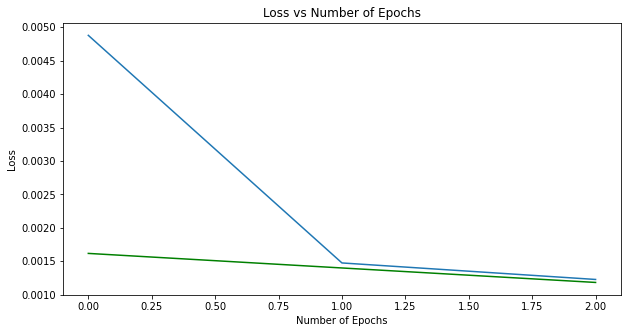

In [48]:
# Plot loss
num_epochs = np.arange(len(train_loss_set))

fig, ax = plt.subplots(figsize=(10, 5));
ax.plot(num_epochs, np.array(train_loss_set), label="Train Loss")
ax.plot(num_epochs, np.array(valid_loss_set), 'g-', label="Valid Loss")
#ax1.plot(episode_record, lose_record, 'r-', label="Lose %")
ax.set_xlabel("Number of Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Number of Epochs")

## Train Model From Previous Checkpoint

In [49]:
cwd = os.getcwd()
model_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/Models/xlnet_toxic.bin")
model, start_epoch, lowest_eval_loss, train_loss_hist, valid_loss_hist = load_model(model_save_path)

In [50]:
optimizer = AdamW(model.parameters(), lr=2e-5, weight_decay=0.01, correct_bias=False)

In [51]:
num_epochs=3
model, train_loss_set, valid_loss_set = train(model=model,\
                                              num_epochs=num_epochs,\
                                              optimizer=optimizer,\
                                              train_dataloader=train_dataloader,\
                                              valid_dataloader=validation_dataloader,\
                                              model_save_path=model_save_path,\
                                              train_loss_set=train_loss_hist,\
                                              valid_loss_set=valid_loss_hist,\
                                              lowest_eval_loss=lowest_eval_loss,\
                                              start_epoch=start_epoch,\
                                              device="cuda")

Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Train loss: 0.0011744442282330125
Valid loss: 0.0010896257241461854


Epoch:  33%|███▎      | 1/3 [03:08<06:16, 188.46s/it]

Saving model at epoch 2 with validation loss of 0.0010896257241461854


Train loss: 0.0008177581371150437
Valid loss: 0.0010181357533830288


Epoch:  67%|██████▋   | 2/3 [06:16<03:08, 188.48s/it]

Saving model at epoch 3 with validation loss of 0.0010181357533830288


Train loss: 0.000601592400052022
Valid loss: 0.0010041986383510855


Epoch: 100%|██████████| 3/3 [09:25<00:00, 188.44s/it]

Saving model at epoch 4 with validation loss of 0.0010041986383510855




Text(0.5, 1.0, 'Loss vs Number of Epochs')

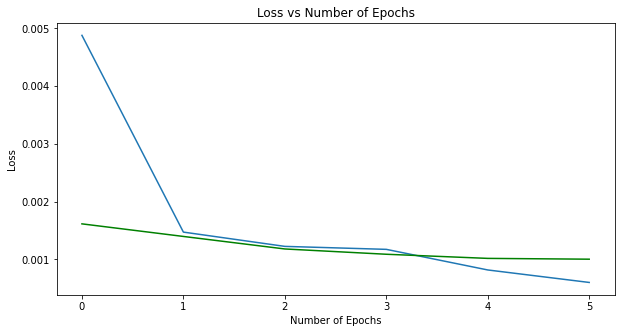

In [52]:
# Plot loss
num_epochs = np.arange(len(train_loss_set))

fig, ax = plt.subplots(figsize=(10, 5));
ax.plot(num_epochs, np.array(train_loss_set), label="Train Loss")
ax.plot(num_epochs, np.array(valid_loss_set), 'g-', label="Valid Loss")
#ax1.plot(episode_record, lose_record, 'r-', label="Lose %")
ax.set_xlabel("Number of Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Number of Epochs")

## Get Predictions

In [53]:
def generate_predictions(model, df, num_labels, device="cpu", batch_size=32):
  num_iter = math.ceil(df.shape[0]/batch_size)
  
  pred_probs = np.array([]).reshape(0, num_labels)
  
  model.to(device)
  model.eval()
  
  for i in range(num_iter):
    df_subset = df.iloc[i*batch_size:(i+1)*batch_size,:]
    X = df_subset["features"].values.tolist()
    masks = df_subset["masks"].values.tolist()
    X = torch.tensor(X)
    masks = torch.tensor(masks, dtype=torch.long)
    X = X.to(device)
    masks = masks.to(device)
    with torch.no_grad():
      logits = model(input_ids=X, attention_mask=masks)
      logits = logits.sigmoid().detach().cpu().numpy()
      pred_probs = np.vstack([pred_probs, logits])
  
  return pred_probs

In [54]:
num_labels = len(tagList)
pred_probs = generate_predictions(model, test, num_labels, device="cuda", batch_size=32)
pred_probs

array([[1.26567029e-03, 2.48483237e-04, 4.23330712e-05, ...,
        4.10695822e-04, 2.96229636e-03, 6.16742251e-03],
       [4.06307896e-04, 2.81858549e-04, 1.24966655e-05, ...,
        6.69095665e-04, 3.17350205e-04, 2.51518708e-04],
       [1.71630440e-04, 1.05801802e-04, 2.43001941e-05, ...,
        3.74781317e-04, 6.64278225e-04, 1.36766786e-04],
       ...,
       [1.56475289e-04, 1.78275048e-04, 3.20918184e-06, ...,
        9.72566413e-05, 2.03949996e-04, 8.17985798e-04],
       [1.42025959e-03, 1.41364487e-03, 2.30768255e-05, ...,
        2.81601766e-04, 7.05325918e-04, 5.74108621e-04],
       [5.64368791e-04, 4.94592125e-04, 1.18288200e-03, ...,
        2.16249586e-03, 3.67410411e-03, 1.48051200e-04]])

In [55]:
label_cols = tagList

for idx,tag in enumerate(tagList):
  test[tag] = pred_probs[:,idx]

In [56]:
test.head()

,id,tags,text,lemmas,features,masks,3dprint,aclu,amazon,android,antitrust,apple,apps,asana,auth0,azure,backyard,biden,biology,bitcoin,books,brain,charity,china,chrissy,ci/cd,class,climate,color,compsci,computer,computererrors,computersecurity,conservatism,conspiracies,conversations,cooperstown,cosmosdb,covid,cpp,...,sip,snowden,solar,space,spacy,sparkfile,spectre,sql,statistics,stb,swagger,sysadmin,sysctr,tax,tdd,technology,testing,toomanylaws,travel,travelhacking,trump,typescript,unions,visualstudio,voting,vpn,vscode,vsto,waitbutwhy,walking,watch,wedding,wifi,will,windows,xamarin,xaml,xml,xpath,zettelkasten
0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ...","[13295, 9756, 25, 18957, 6687, 213, 218, 4538,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.001266,0.000248,0.000042,0.003195,0.000158,0.000616,0.000444,0.012837,0.001569,0.007551,0.000160,0.000142,0.000119,0.000115,0.000803,0.000061,0.000457,0.000221,0.000030,0.007454,0.000003,0.000257,0.000278,0.000181,0.017139,0.000154,0.000111,0.000537,0.000069,0.000069,0.000059,0.001402,0.000113,0.000862,...,0.001666,0.001055,2.415137e-06,0.001182,7.737671e-05,0.008391,0.000249,0.007444,0.000332,0.000308,0.003009,0.000532,0.000008,0.000359,0.002947,0.000077,0.003379,0.000188,0.000079,0.000196,0.000770,0.000996,0.000007,0.009443,1.219350e-05,0.000839,0.016136,0.000728,0.000025,0.000125,0.000142,0.000051,0.000205,0.000281,0.012631,0.026052,0.000298,0.000411,0.002962,0.006167
1,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b...","[534, 649, 20, 31356, 13470, 4538, 23, 4315, 3...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000406,0.000282,0.000012,0.001188,0.000156,0.000238,0.000177,0.001328,0.003878,0.000249,0.000032,0.000098,0.000110,0.000116,0.001871,0.000116,0.000046,0.000268,0.000004,0.000339,0.000090,0.000107,0.000266,0.000863,0.034827,0.000173,0.106475,0.000078,0.000041,0.000145,0.000453,0.000273,0.000344,0.000946,...,0.001527,0.001424,1.953341e-05,0.001958,1.947164e-04,0.000655,0.000380,0.003402,0.000202,0.000041,0.000828,0.000106,0.000043,0.000622,0.008188,0.000532,0.000078,0.000081,0.000163,0.000602,0.000776,0.000647,0.000031,0.000714,1.826340e-05,0.000323,0.000896,0.000105,0.000196,0.000095,0.000324,0.000108,0.000169,0.000450,0.007719,0.009787,0.000051,0.000669,0.000317,0.000252
2,1016000946,[],Raft Consensus Algorithm\nhttps://raft.github....,"[raft, consensus, algorithm, raft, raft, imple...","[15297, 7169, 13301, 4538, 23, 4315, 840, 2378...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000172,0.000106,0.000024,0.002235,0.000086,0.000894,0.000121,0.004933,0.004888,0.002658,0.000138,0.000035,0.000048,0.000088,0.000635,0.000031,0.000075,0.000049,0.000015,0.001013,0.000041,0.000078,0.000198,0.002346,0.623187,0.000547,0.003581,0.000072,0.000120,0.000049,0.000382,0.000959,0.000637,0.001521,...,0.003712,0.000946,8.175721e-06,0.001288,1.150365e-04,0.000360,0.002832,0.011328,0.000396,0.000043,0.000568,0.000078,0.000031,0.000097,0.004714,0.000578,0.000136,0.000044,0.000011,0.000194,0.001306,0.000538,0.000006,0.000304,1.908093e-05,0.000223,0.002668,0.000321,0.000177,0.000051,0.000173,0.000050,0.000411,0.000229,0.036645,0.002230,0.000072,0.000375,0.000664,0.000137
3,1017755607,[],0xd4d/dnSpy\nhttps://github.com/0xd4d/dnSpy\nC...,"[dnspi, com, dnspi, call, stack, thread, modul...","[700, 469, 66, 265, 66, 167, 66, 3673, 4546, 4...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000510,0.000031,0.000078,0.000228,0.000031,0.001076,0.000208,0.000407,0.021692,0.091850,0.000026,0.000289,0.000148,0.000094,0.000127,0.000034,0.000258,0.000226,0.000024,0.010064,0.000028,0.000090,0.000031,0.000893,0.009242,0.000195,0.000138,0.000386,0.000109,0.000078,0.000224,0.005115,0.000198,0.008168,...,0.003577,0.000223,1.180999e-04,0.009657,1.482354e-04,0.000995,0.001366,0.040683,0.000083,0.000069,0.001061,0.000174,0.000039,0.001388,0.0052

In [57]:
maxValues = test[tagList].idxmax(axis = 1) 
maxValues

0         programming
1         programming
2            computer
3              csharp
4             xamarin
            ...      
1402          compsci
1403    deep learning
1404     mentalmodels
1405        microsoft
1406      raspberrypi
Length: 1407, dtype: object

In [58]:
test['ModelTag'] = maxValues

In [59]:
test.head()

,id,tags,text,lemmas,features,masks,3dprint,aclu,amazon,android,antitrust,apple,apps,asana,auth0,azure,backyard,biden,biology,bitcoin,books,brain,charity,china,chrissy,ci/cd,class,climate,color,compsci,computer,computererrors,computersecurity,conservatism,conspiracies,conversations,cooperstown,cosmosdb,covid,cpp,...,snowden,solar,space,spacy,sparkfile,spectre,sql,statistics,stb,swagger,sysadmin,sysctr,tax,tdd,technology,testing,toomanylaws,travel,travelhacking,trump,typescript,unions,visualstudio,voting,vpn,vscode,vsto,waitbutwhy,walking,watch,wedding,wifi,will,windows,xamarin,xaml,xml,xpath,zettelkasten,ModelTag
0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ...","[13295, 9756, 25, 18957, 6687, 213, 218, 4538,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.001266,0.000248,0.000042,0.003195,0.000158,0.000616,0.000444,0.012837,0.001569,0.007551,0.000160,0.000142,0.000119,0.000115,0.000803,0.000061,0.000457,0.000221,0.000030,0.007454,0.000003,0.000257,0.000278,0.000181,0.017139,0.000154,0.000111,0.000537,0.000069,0.000069,0.000059,0.001402,0.000113,0.000862,...,0.001055,2.415137e-06,0.001182,7.737671e-05,0.008391,0.000249,0.007444,0.000332,0.000308,0.003009,0.000532,0.000008,0.000359,0.002947,0.000077,0.003379,0.000188,0.000079,0.000196,0.000770,0.000996,0.000007,0.009443,1.219350e-05,0.000839,0.016136,0.000728,0.000025,0.000125,0.000142,0.000051,0.000205,0.000281,0.012631,0.026052,0.000298,0.000411,0.002962,0.006167,programming
1,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b...","[534, 649, 20, 31356, 13470, 4538, 23, 4315, 3...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000406,0.000282,0.000012,0.001188,0.000156,0.000238,0.000177,0.001328,0.003878,0.000249,0.000032,0.000098,0.000110,0.000116,0.001871,0.000116,0.000046,0.000268,0.000004,0.000339,0.000090,0.000107,0.000266,0.000863,0.034827,0.000173,0.106475,0.000078,0.000041,0.000145,0.000453,0.000273,0.000344,0.000946,...,0.001424,1.953341e-05,0.001958,1.947164e-04,0.000655,0.000380,0.003402,0.000202,0.000041,0.000828,0.000106,0.000043,0.000622,0.008188,0.000532,0.000078,0.000081,0.000163,0.000602,0.000776,0.000647,0.000031,0.000714,1.826340e-05,0.000323,0.000896,0.000105,0.000196,0.000095,0.000324,0.000108,0.000169,0.000450,0.007719,0.009787,0.000051,0.000669,0.000317,0.000252,programming
2,1016000946,[],Raft Consensus Algorithm\nhttps://raft.github....,"[raft, consensus, algorithm, raft, raft, imple...","[15297, 7169, 13301, 4538, 23, 4315, 840, 2378...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000172,0.000106,0.000024,0.002235,0.000086,0.000894,0.000121,0.004933,0.004888,0.002658,0.000138,0.000035,0.000048,0.000088,0.000635,0.000031,0.000075,0.000049,0.000015,0.001013,0.000041,0.000078,0.000198,0.002346,0.623187,0.000547,0.003581,0.000072,0.000120,0.000049,0.000382,0.000959,0.000637,0.001521,...,0.000946,8.175721e-06,0.001288,1.150365e-04,0.000360,0.002832,0.011328,0.000396,0.000043,0.000568,0.000078,0.000031,0.000097,0.004714,0.000578,0.000136,0.000044,0.000011,0.000194,0.001306,0.000538,0.000006,0.000304,1.908093e-05,0.000223,0.002668,0.000321,0.000177,0.000051,0.000173,0.000050,0.000411,0.000229,0.036645,0.002230,0.000072,0.000375,0.000664,0.000137,computer
3,1017755607,[],0xd4d/dnSpy\nhttps://github.com/0xd4d/dnSpy\nC...,"[dnspi, com, dnspi, call, stack, thread, modul...","[700, 469, 66, 265, 66, 167, 66, 3673, 4546, 4...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000510,0.000031,0.000078,0.000228,0.000031,0.001076,0.000208,0.000407,0.021692,0.091850,0.000026,0.000289,0.000148,0.000094,0.000127,0.000034,0.000258,0.000226,0.000024,0.010064,0.000028,0.000090,0.000031,0.000893,0.009242,0.000195,0.000138,0.000386,0.000109,0.000078,0.000224,0.005115,0.000198,0.008168,...,0.000223,1.180999e-04,0.009657,1.482354e-04,0.000995,0.001366,0.040683,0.000083,0.000069,0.001061,0.000174,0.000039,0.001388,0.00

In [60]:
test_to_csv = test.reset_index()
test_to_csv.head()

,index,id,tags,text,lemmas,features,masks,3dprint,aclu,amazon,android,antitrust,apple,apps,asana,auth0,azure,backyard,biden,biology,bitcoin,books,brain,charity,china,chrissy,ci/cd,class,climate,color,compsci,computer,computererrors,computersecurity,conservatism,conspiracies,conversations,cooperstown,cosmosdb,covid,...,snowden,solar,space,spacy,sparkfile,spectre,sql,statistics,stb,swagger,sysadmin,sysctr,tax,tdd,technology,testing,toomanylaws,travel,travelhacking,trump,typescript,unions,visualstudio,voting,vpn,vscode,vsto,waitbutwhy,walking,watch,wedding,wifi,will,windows,xamarin,xaml,xml,xpath,zettelkasten,ModelTag
0,0,1001316036,[],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ...","[13295, 9756, 25, 18957, 6687, 213, 218, 4538,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.001266,0.000248,0.000042,0.003195,0.000158,0.000616,0.000444,0.012837,0.001569,0.007551,0.000160,0.000142,0.000119,0.000115,0.000803,0.000061,0.000457,0.000221,0.000030,0.007454,0.000003,0.000257,0.000278,0.000181,0.017139,0.000154,0.000111,0.000537,0.000069,0.000069,0.000059,0.001402,0.000113,...,0.001055,2.415137e-06,0.001182,7.737671e-05,0.008391,0.000249,0.007444,0.000332,0.000308,0.003009,0.000532,0.000008,0.000359,0.002947,0.000077,0.003379,0.000188,0.000079,0.000196,0.000770,0.000996,0.000007,0.009443,1.219350e-05,0.000839,0.016136,0.000728,0.000025,0.000125,0.000142,0.000051,0.000205,0.000281,0.012631,0.026052,0.000298,0.000411,0.002962,0.006167,programming
1,1,1007374287,[],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b...","[534, 649, 20, 31356, 13470, 4538, 23, 4315, 3...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000406,0.000282,0.000012,0.001188,0.000156,0.000238,0.000177,0.001328,0.003878,0.000249,0.000032,0.000098,0.000110,0.000116,0.001871,0.000116,0.000046,0.000268,0.000004,0.000339,0.000090,0.000107,0.000266,0.000863,0.034827,0.000173,0.106475,0.000078,0.000041,0.000145,0.000453,0.000273,0.000344,...,0.001424,1.953341e-05,0.001958,1.947164e-04,0.000655,0.000380,0.003402,0.000202,0.000041,0.000828,0.000106,0.000043,0.000622,0.008188,0.000532,0.000078,0.000081,0.000163,0.000602,0.000776,0.000647,0.000031,0.000714,1.826340e-05,0.000323,0.000896,0.000105,0.000196,0.000095,0.000324,0.000108,0.000169,0.000450,0.007719,0.009787,0.000051,0.000669,0.000317,0.000252,programming
2,2,1016000946,[],Raft Consensus Algorithm\nhttps://raft.github....,"[raft, consensus, algorithm, raft, raft, imple...","[15297, 7169, 13301, 4538, 23, 4315, 840, 2378...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000172,0.000106,0.000024,0.002235,0.000086,0.000894,0.000121,0.004933,0.004888,0.002658,0.000138,0.000035,0.000048,0.000088,0.000635,0.000031,0.000075,0.000049,0.000015,0.001013,0.000041,0.000078,0.000198,0.002346,0.623187,0.000547,0.003581,0.000072,0.000120,0.000049,0.000382,0.000959,0.000637,...,0.000946,8.175721e-06,0.001288,1.150365e-04,0.000360,0.002832,0.011328,0.000396,0.000043,0.000568,0.000078,0.000031,0.000097,0.004714,0.000578,0.000136,0.000044,0.000011,0.000194,0.001306,0.000538,0.000006,0.000304,1.908093e-05,0.000223,0.002668,0.000321,0.000177,0.000051,0.000173,0.000050,0.000411,0.000229,0.036645,0.002230,0.000072,0.000375,0.000664,0.000137,computer
3,3,1017755607,[],0xd4d/dnSpy\nhttps://github.com/0xd4d/dnSpy\nC...,"[dnspi, com, dnspi, call, stack, thread, modul...","[700, 469, 66, 265, 66, 167, 66, 3673, 4546, 4...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000510,0.000031,0.000078,0.000228,0.000031,0.001076,0.000208,0.000407,0.021692,0.091850,0.000026,0.000289,0.000148,0.000094,0.000127,0.000034,0.000258,0.000226,0.000024,0.010064,0.000028,0.000090,0.000031,0.000893,0.009242,0.000195,0.000138,0.000386,0.000109,0.000078,0.000224,0.005115,0.000198,...,0.000223,1.180999e-04,0.009657,1.482354e-04,0.000995,0.001366,0.040683,0.000083,0.000069,0.001061,0.000174,0.000039,0.001388,0.005207,0.000056,0.000701,0.0

In [61]:
cwd = os.getcwd()
pred_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/data/pocket_1_epoch.csv")
test_to_csv.to_csv(pred_save_path, index=False)

In [62]:
np.round(pred_probs)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])